# 3. Via Human Hematopoiesis

This notebook uses VIA to interpret the CD34 Hematopoiesis dataset (Setty et al.,2019) 

In [1]:
import pyVIA.core as via
import pyVIA.datasets_via as   datasets
import pandas as pd 
import scanpy as sc

import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

## Load data from directory
We use annotations given by SingleR which uses Novershtern Hematopoietic cell data as the reference. These are in line with the annotations given by Setty et al., 2019 but offer a slightly more granular annotation.

In [2]:
adata = datasets.scRNA_hematopoiesis()
sc.tl.pca(adata, svd_solver='arpack', n_comps=200)
tsnem = adata.obsm['tsne']
adata

Cell type CMP has  968 cells
Cell type PRE_B3 has  2 cells
Cell type B_a4 has  8 cells
Cell type pDC has  204 cells
Cell type HSC2 has  10 cells
Cell type GRAN1 has  3 cells
Cell type Nka3 has  5 cells
Cell type EOS2 has  3 cells
Cell type MONO1 has  186 cells
Cell type B_a1 has  27 cells
Cell type ERY3 has  104 cells
Cell type ERY1 has  773 cells
Cell type HSC1 has  2365 cells
Cell type MONO2 has  35 cells
Cell type ERY2 has  40 cells
Cell type mDC (cDC) has  96 cells
Cell type B_a2 has  1 cells
Cell type BASO1 has  2 cells
Cell type ERY4 has  53 cells
Cell type MEP has  339 cells
Cell type PRE_B2 has  515 cells
Cell type TCEL7 has  1 cells
Cell type GMP has  28 cells
Cell type MEGA1 has  12 cells


AnnData object with n_obs × n_vars = 5780 × 14651
    obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'label'
    uns: 'cluster_colors', 'ct_colors', 'palantir_branch_probs_cell_types', 'pca'
    obsm: 'tsne', 'MAGIC_imputed_data', 'palantir_branch_probs', 'X_pca'
    varm: 'PCs'

## User's choice of embedding
Three embedding exmaples: TSNE, UMAP, and PHATE 
Alternatively allow via.VIA() to compute an embedding using the underlying graph by setting: do_embedding = True AND embedding_type = 'via-umap' OR 'via-mds'

In [3]:
# TSNE - same as the embedding used in the original Setty et al., publication
embedding = adata.obsm['tsne']

# # UMAP
# ncomp = 30
# embedding = umap.UMAP().fit_transform(adata.obsm['X_pca'][:, 0:ncomp])

# # PHATE
# ncomp = 30
# phate_op = phate.PHATE()
# embedding = phate_op.fit_transform(adata.obsm['X_pca'][:, 0:ncomp])

## Run VIA
#### Key Parameters:
- knn
- root_user (root index of type int/ or celltype label of type string)
- edgepruning_clustering_resolution (lower number means smaller (and more) clusters) typical range 0-1
- memory (higher value means more focused search pathways to cell fates) typical range 2-50
- cluster_graph_pruning (lower number means fewer edges) typical range 0-1
- dataset (relates to the root_user parameter. if the root is an index, the leave as dataset =''. If the root is a celltype label found in true_label paramters, then dataset='group')


In [4]:
ncomps=80
knn=30
v0_random_seed=4
root_user = [4823] #the index of a cell belonging to the HSC cell type
memory = 10
dataset = ''

'''
#NOTE1, if you decide to choose a cell type as a root, then you need to set the dataset as 'group'
#root_user=['HSC1']
#dataset = 'group'# 'humanCD34'
#NOTE2, if rna-velocity is available, considering using it to compute the root automatically- see RNA velocity tutorial
'''

v0 = via.VIA(data=adata.obsm['X_pca'][:, 0:ncomps], true_label=adata.obs['label'], 
             edgepruning_clustering_resolution=0.15, cluster_graph_pruning=0.15,
             knn=knn,  root_user=root_user, resolution_parameter=1.5,
             dataset=dataset, random_seed=v0_random_seed, memory=memory)#, do_compute_embedding=True, embedding_type='via-atlas')

v0.run_VIA()

#NOTE2: if you want to pre-specify terminal states you can do so by a list of group-level names corresponding to true-labels OR by a list of single cell indices
#E.G. user_defined_terminal_group=['pDC','ERY1', 'ERY3', 'MONO1','mDC (cDC)','PRE_B2']

2023-10-30 14:26:27.296505	Running VIA over input data of 5780 (samples) x 80 (features)
2023-10-30 14:26:27.296612	Knngraph has 30 neighbors
2023-10-30 14:26:31.954335	Finished global pruning of 30-knn graph used for clustering at level of 0.15. Kept 46.3 % of edges. 
2023-10-30 14:26:32.011295	Number of connected components used for clustergraph  is 1
2023-10-30 14:26:32.503636	Commencing community detection
2023-10-30 14:26:32.631581	Finished running Leiden algorithm. Found 212 clusters.
2023-10-30 14:26:32.637560	Merging 188 very small clusters (<10)
2023-10-30 14:26:32.642614	Finished detecting communities. Found 24 communities
2023-10-30 14:26:32.643731	Making cluster graph. Global cluster graph pruning level: 0.15
2023-10-30 14:26:32.673200	Graph has 1 connected components before pruning
2023-10-30 14:26:32.676487	Graph has 2 connected components after pruning
2023-10-30 14:26:32.678096	Graph has 1 connected components after reconnecting
2023-10-30 14:26:32.678934	0.0% links tri

  0%|          | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
do scaling of pt
2023-10-30 14:26:40.339327	Identifying terminal clusters corresponding to unique lineages...
2023-10-30 14:26:40.339362	Closeness:[1, 7, 8, 11, 12, 13, 15, 18]
2023-10-30 14:26:40.339379	Betweenness:[1, 3, 6, 7, 11, 12, 13, 15, 18, 20, 21, 22]
2023-10-30 14:26:40.339392	Out Degree:[1, 5, 7, 8, 9, 11, 12, 13, 15, 18, 20, 22]
2023-10-30 14:26:40.340052	Terminal clusters corresponding to unique lineages in this component are [7, 11, 12, 15, 18, 20, 22] 
TESTING rw2_lineage probability at memory 10
testing rw2 lineage probability at memory 10
g.indptr.size, 25


  0%|          | 0/1000 [00:00<?, ?it/s]

2023-10-30 14:26:44.688612	 Cluster or terminal cell fate 7 is reached 11.0 times
2023-10-30 14:26:44.769144	 Cluster or terminal cell fate 11 is reached 189.0 times
2023-10-30 14:26:44.857752	 Cluster or terminal cell fate 12 is reached 11.0 times
2023-10-30 14:26:44.957626	 Cluster or terminal cell fate 15 is reached 303.0 times
2023-10-30 14:26:45.048059	 Cluster or terminal cell fate 18 is reached 155.0 times
2023-10-30 14:26:45.125893	 Cluster or terminal cell fate 20 is reached 644.0 times
2023-10-30 14:26:45.201391	 Cluster or terminal cell fate 22 is reached 709.0 times
2023-10-30 14:26:45.213079	There are (7) terminal clusters corresponding to unique lineages {7: 'PRE_B2', 11: 'ERY3', 12: 'PRE_B2', 15: 'MONO1', 18: 'ERY1', 20: 'pDC', 22: 'mDC (cDC)'}
2023-10-30 14:26:45.213129	Begin projection of pseudotime and lineage likelihood
2023-10-30 14:26:46.728132	Cluster graph layout based on forward biasing
2023-10-30 14:26:46.732186	Starting make edgebundle viagraph...
2023-10-30 1

## Cluster Level Trajectory Plots

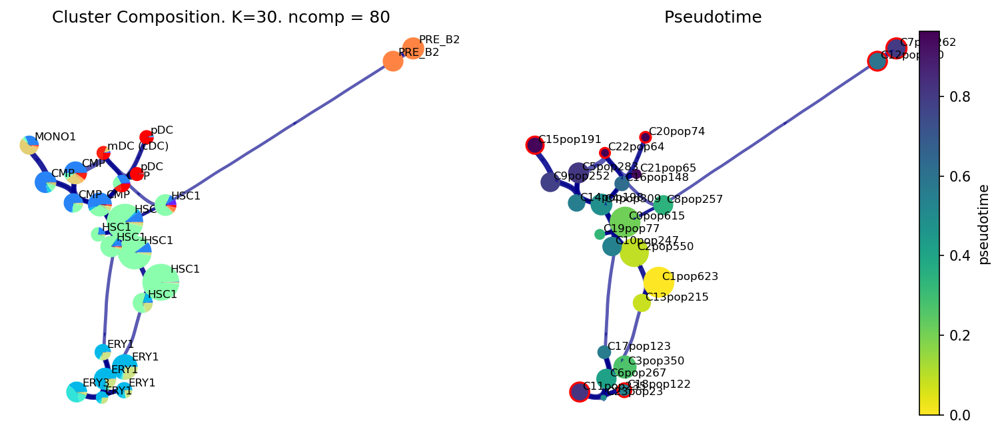

In [5]:
fig, ax, ax1 = via.plot_piechart_viagraph(via_object=v0, show_legend=False)
fig.set_size_inches(12,5)

## Visualise gene/feature graph
View the gene expression along the VIA graph. We use the computed HNSW small world graph in VIA to accelerate the gene imputation calculations (using similar approach to MAGIC) as follows:


shape of transition matrix raised to power 3 (5780, 5780)


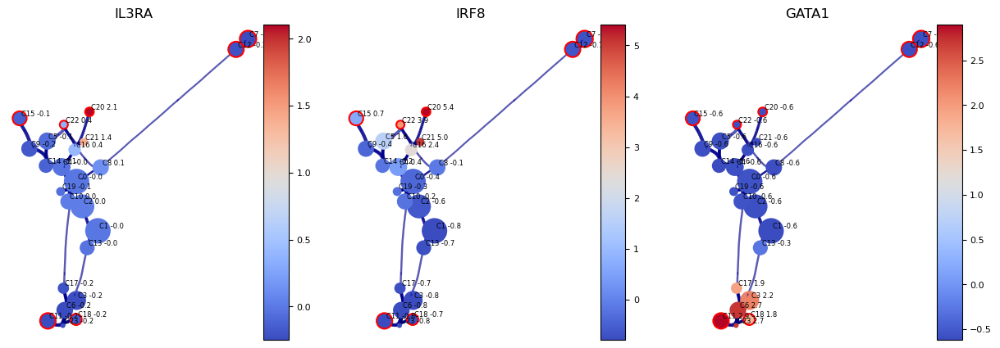

In [6]:
df_ = pd.DataFrame(adata.X)
df_.columns = [i for i in adata.var_names]

gene_list_magic = ['IL3RA', 'IRF8', 'GATA1', 'GATA2', 'ITGA2B', 'MPO', 'CD79B', 'SPI1', 'CD34', 'CSF1R', 'ITGAX']

#optional to do gene expression imputation

df_magic = v0.do_impute(df_, magic_steps=3, gene_list=gene_list_magic)

fig, axs = via.plot_viagraph(via_object=v0, type_data='gene', df_genes=df_magic, gene_list=gene_list_magic[0:3], arrow_head=0.1)
fig.set_size_inches(15,5)

## Trajectory projection

Visualize the overall VIA trajectory projected onto a 2D embedding (UMAP, Phate, TSNE etc) in different ways. 

1. Draw the high-level clustergraph abstraction onto the embedding;
2. Draw high-edge resolution directed graph
3. Draw a vector field/stream plot of the more fine-grained directionality of cells along the trajectory projected onto an embedding. 


#### Key Parameters:
- scatter_size
- scatter_alpha
- linewidth
- draw_all_curves (if too crowded, set to False)

100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:01 Time:  0:00:01
100% (11 of 11) |#######################

2023-10-30 13:55:26.039883	Super cluster 7 is a super terminal with sub_terminal cluster 7
2023-10-30 13:55:26.040203	Super cluster 9 is a super terminal with sub_terminal cluster 9
2023-10-30 13:55:26.040240	Super cluster 11 is a super terminal with sub_terminal cluster 11
2023-10-30 13:55:26.040271	Super cluster 12 is a super terminal with sub_terminal cluster 12
2023-10-30 13:55:26.040304	Super cluster 15 is a super terminal with sub_terminal cluster 15
2023-10-30 13:55:26.040351	Super cluster 18 is a super terminal with sub_terminal cluster 18
2023-10-30 13:55:26.040382	Super cluster 20 is a super terminal with sub_terminal cluster 20
2023-10-30 13:55:26.040412	Super cluster 21 is a super terminal with sub_terminal cluster 21
2023-10-30 13:55:26.040441	Super cluster 22 is a super terminal with sub_terminal cluster 22


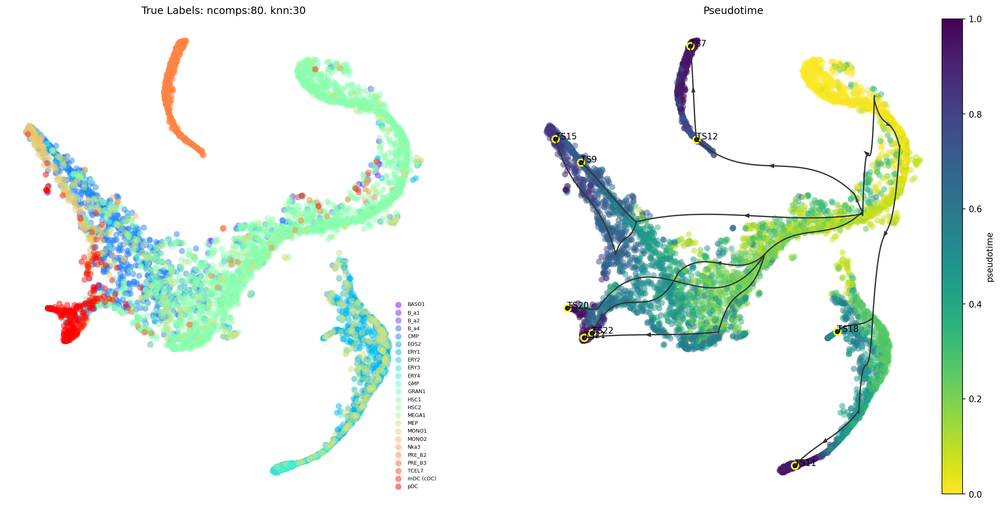

In [31]:
fig, ax, ax1 = via.plot_trajectory_curves(via_object=v0,embedding=tsnem, draw_all_curves=False)

inside add sc embedding second if


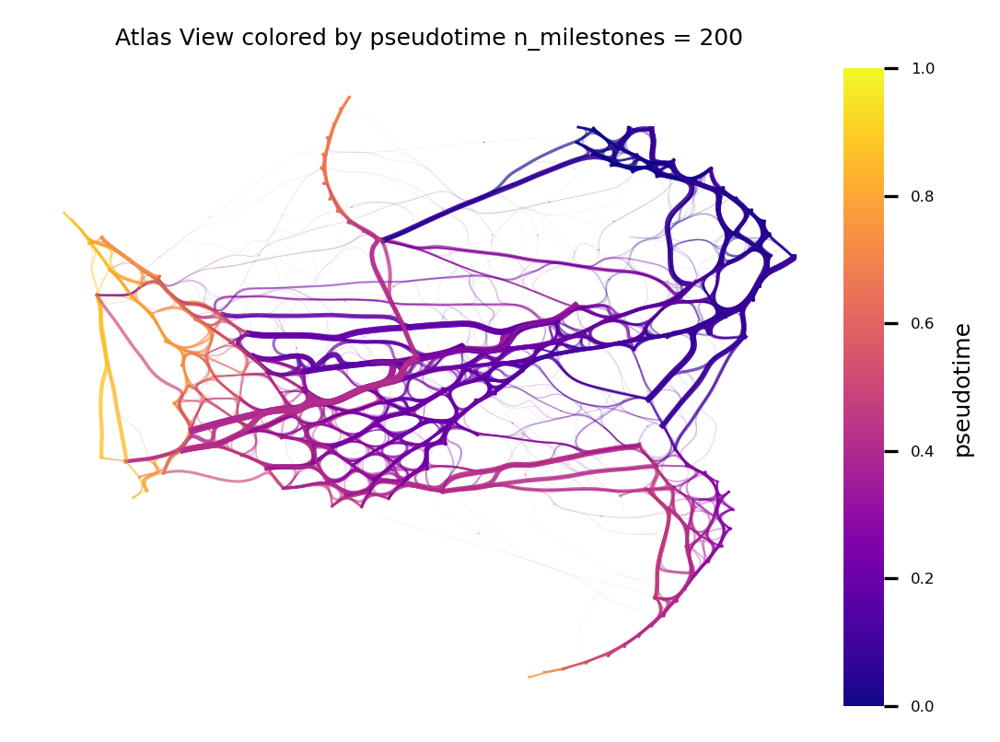

In [18]:
v0.embedding = tsnem
fig, ax = via.plot_atlas_view(via_object=v0,  n_milestones=150, sc_labels=adata.obs['label'], fontsize_labels=3, extra_title_text='Atlas View colored by pseudotime')
fig.set_size_inches(4,3)

In [31]:
# edge plots can be made with different edge resolutions. Run hammerbundle_milestone_dict() to recompute the edges for plotting. Then provide the new hammerbundle as a parameter to plot_edge_bundle()
# it is better to compute the edges and save them to the via_object. this gives more control to the merging of edges
decay = 0.6 #increasing decay increasing merging of edges
i_bw = 0.02 #increasing bw increases merging of edges
global_visual_pruning = 0.5 #higher number retains more edges
n_milestones = 200

v0.hammerbundle_milestone_dict= via.make_edgebundle_milestone(via_object=v0, n_milestones=n_milestones, decay=decay, initial_bandwidth=i_bw, global_visual_pruning=global_visual_pruning)

2023-10-30 15:03:28.888865	Start finding milestones
2023-10-30 15:03:33.107973	End milestones with 200
2023-10-30 15:03:33.130700	Recompute weights
2023-10-30 15:03:33.163942	pruning milestone graph based on recomputed weights
2023-10-30 15:03:33.165341	Graph has 1 connected components before pruning
2023-10-30 15:03:33.166303	Graph has 1 connected components after pruning
2023-10-30 15:03:33.166606	Graph has 1 connected components after reconnecting
2023-10-30 15:03:33.168703	regenerate igraph on pruned edges
2023-10-30 15:03:33.183040	Setting numeric label as single cell pseudotime for coloring edges
2023-10-30 15:03:33.235016	Making smooth edges


inside add sc embedding second if


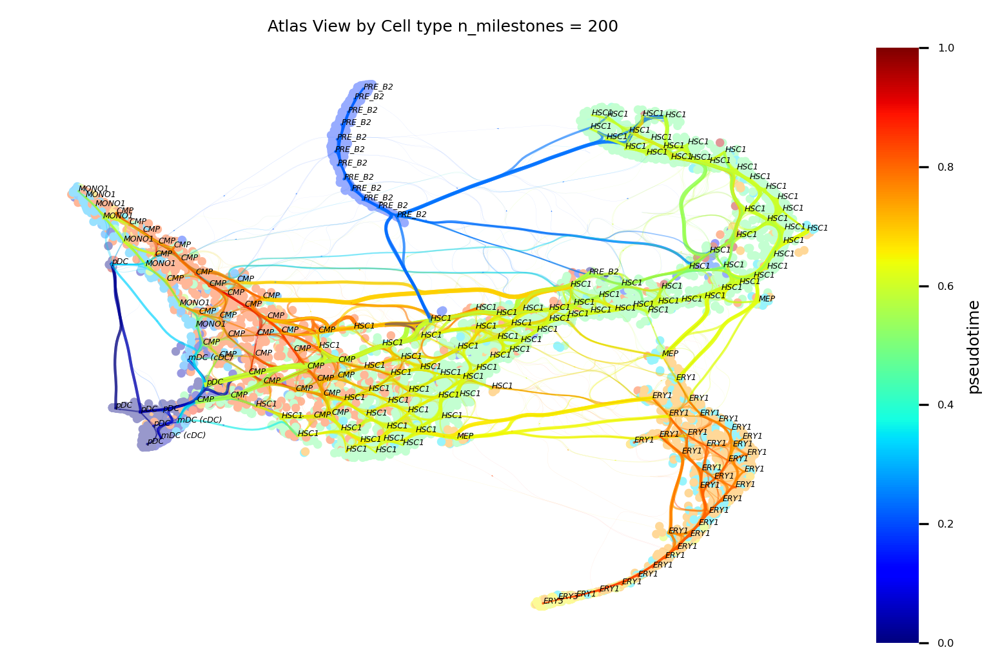

In [32]:
fig, ax = via.plot_atlas_view(via_object=v0,  add_sc_embedding=True, sc_labels_expression=adata.obs['label'], cmap='jet', sc_labels=adata.obs['label'], text_labels=True, extra_title_text='Atlas View by Cell type', fontsize_labels=3)
fig.set_size_inches(6,4)

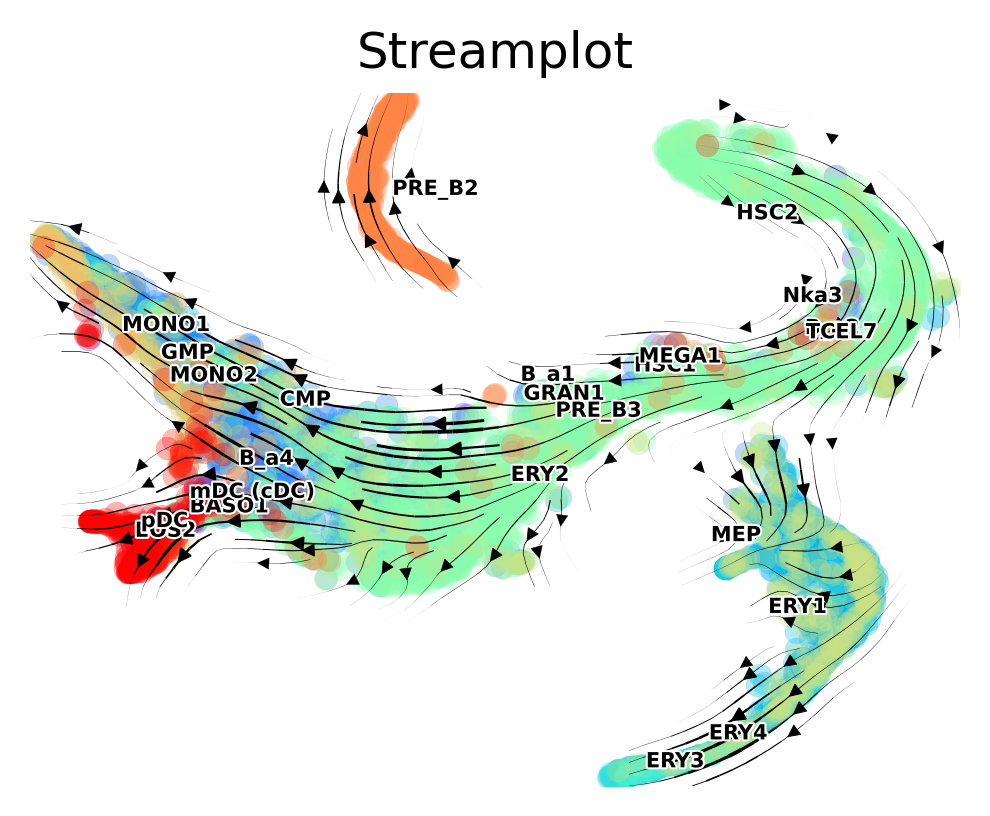

In [19]:
# via_streamplot() requires you to either provide an ndarray as embedding as an input parameter OR for via to have an embedding attribute
fig, ax = via.via_streamplot(v0, embedding=tsnem, density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4,3)

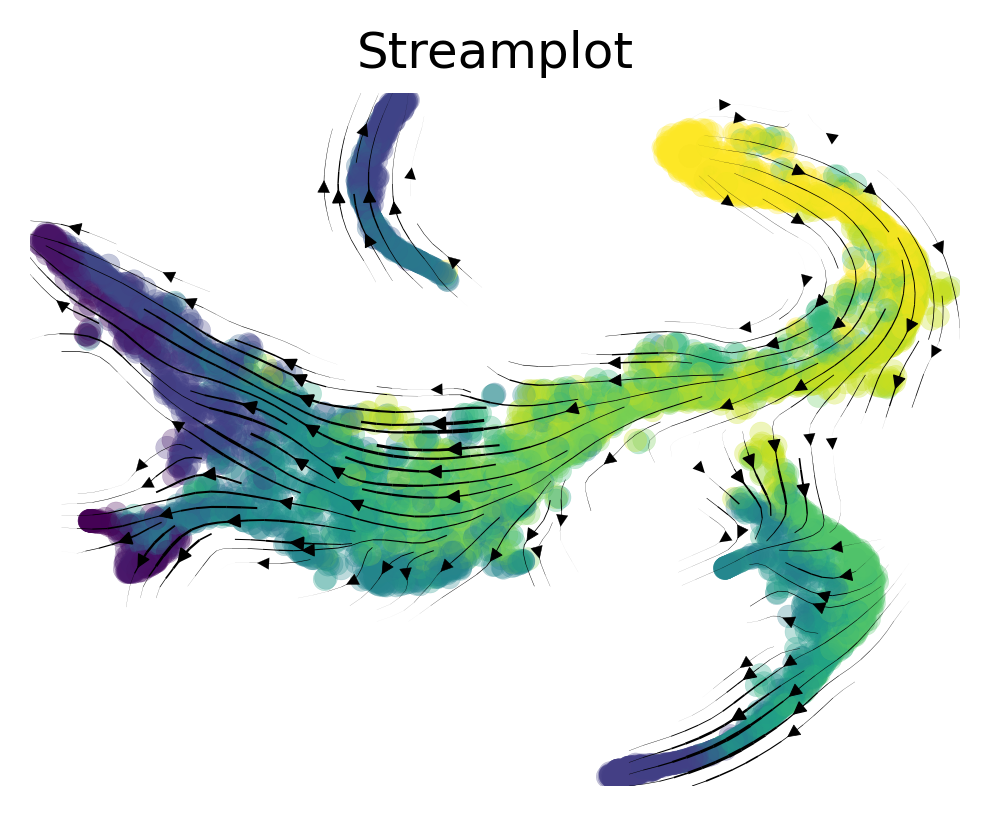

In [20]:
#Colored by pseudotime

fig, ax = via.via_streamplot(v0,density_grid=0.8, scatter_size=30, color_scheme='time', linewidth=0.5, 
                             min_mass = 1, cutoff_perc = 5, scatter_alpha=0.3, marker_edgewidth=0.1, 
                             density_stream = 2, smooth_transition=1, smooth_grid=0.5)
fig.set_size_inches(4,3)

## Probabilistic pathways and Memory
Visualize the probabilistic pathways from root to terminal state as indicated by the lineage likelihood. The higher the linage likelihood, the greater the potential of that particular cell to differentiate towards the terminal state of interest.
Changing the memory paramater will alter the specificity of the lineage pathway. 
This can be visualized at the single-cell level but also combined with the Atlas View which visualizes cell-cell connectivity and pathways

#### Key Parameters:
marker_lineages (list) of terminal clusters

2023-10-30 14:42:00.472388	Marker_lineages: [7, 11, 12, 15, 20, 22]
2023-10-30 14:42:00.476814	The number of components in the original full graph is 1
2023-10-30 14:42:00.476862	For downstream visualization purposes we are also constructing a low knn-graph 
2023-10-30 14:42:05.171433	Check sc pb 0.9999999999999999 
f getting majority comp
2023-10-30 14:42:05.475235	Cluster path on clustergraph starting from Root Cluster 1 to Terminal Cluster 7: [1, 2, 0, 4, 16, 8, 12, 7]
2023-10-30 14:42:05.475274	Cluster path on clustergraph starting from Root Cluster 1 to Terminal Cluster 11: [1, 13, 3, 6, 17, 11]
2023-10-30 14:42:05.475293	Cluster path on clustergraph starting from Root Cluster 1 to Terminal Cluster 12: [1, 2, 0, 4, 16, 8, 12]
2023-10-30 14:42:05.475311	Cluster path on clustergraph starting from Root Cluster 1 to Terminal Cluster 15: [1, 2, 0, 4, 16, 5, 15]
2023-10-30 14:42:05.475328	Cluster path on clustergraph starting from Root Cluster 1 to Terminal Cluster 18: [1, 13, 3, 18]
20

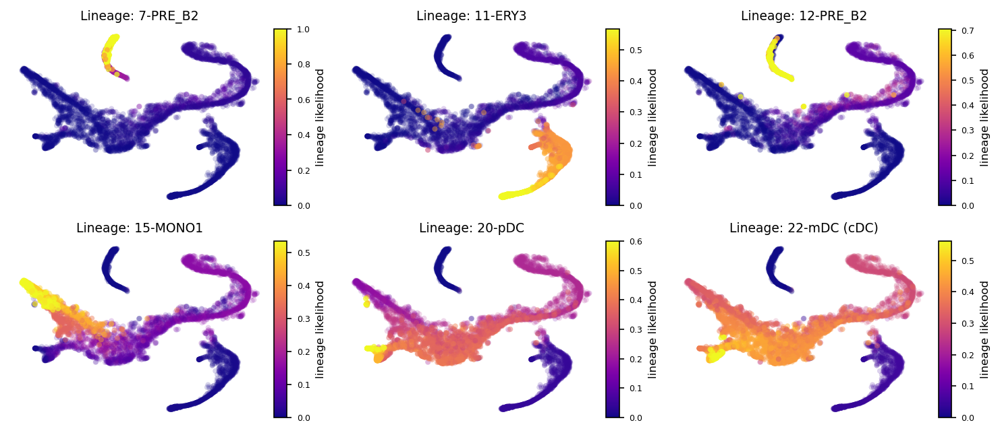

In [23]:
fig, axs= via.plot_sc_lineage_probability(via_object=v0, marker_lineages=[7,11,12,15,20,22], embedding=tsnem) #marker_lineages=v0.terminal_clusters to plot all
fig.set_size_inches(12,5)

location of 7 is at [0] and 0
location of 11 is at [1] and 1
location of 12 is at [2] and 2
location of 15 is at [3] and 3
location of 20 is at [5] and 5
location of 22 is at [6] and 6


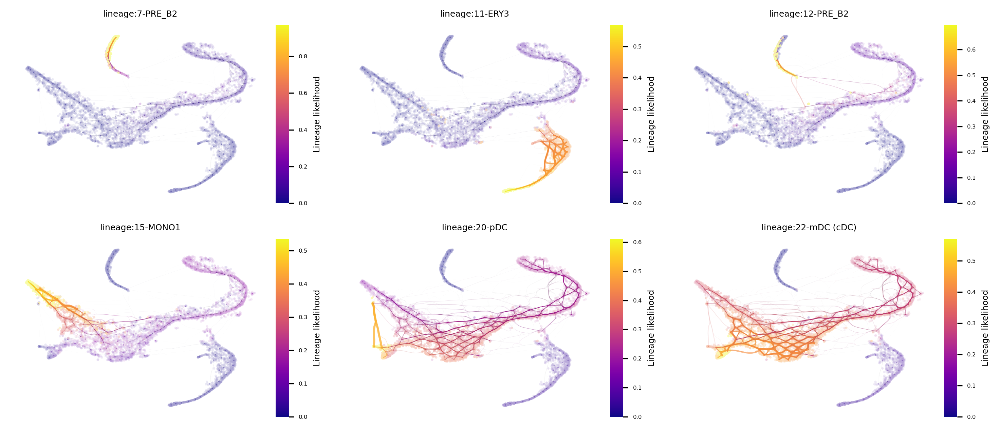

In [28]:
fig, axs= via.plot_atlas_view(via_object=v0, lineage_pathway=[7,11,12,15,20,22]) #marker_lineages=v0.terminal_clusters to plot all
fig.set_size_inches(12,5)

## Gene Dynamics
The gene dynamics along pseudotime for all detected lineages are automatically inferred by VIA. These can be interpreted as the change in gene expression along any given lineage.
#### Key Parameters
- n_splines
- spline_order
- gene_exp (dataframe) single-cell level gene expression of select genes (gene imputation is an optional pre-step)

shape of transition matrix raised to power 3 (5780, 5780)


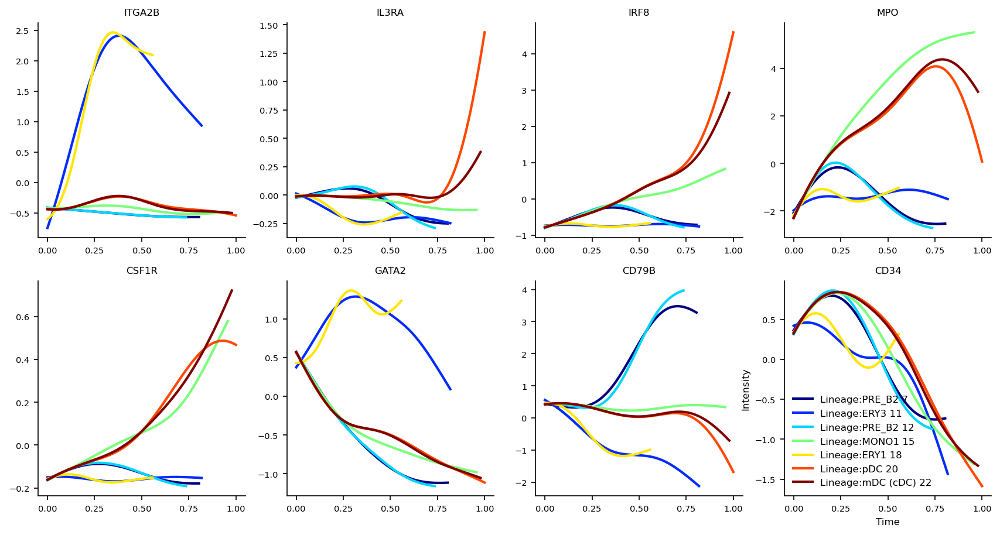

In [25]:
marker_genes =['ITGA2B', 'IL3RA', 'IRF8', 'MPO', 'CSF1R', 'GATA2', 'CD79B', 'CD34']
df = pd.DataFrame(adata.X, columns = adata.var_names)
df_magic = v0.do_impute(df, magic_steps=3, gene_list=gene_list_magic) #optional
fig, axs=via.get_gene_expression(via_object=v0, gene_exp=df_magic[marker_genes])
fig.set_size_inches(14,7)

## Gene Dynamics
Heatmaps of genes along pseudotimetime
#### Key Parameters
- df_gene_exp (dataframe) single-cell level gene expression of selected genes
- marker_lineages (list, optional) to specify which lineages to plot heatmaps for

branches [7, 11]


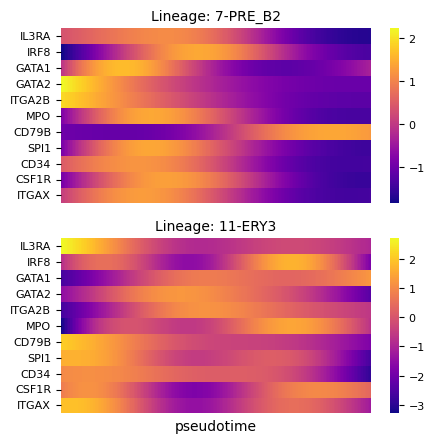

In [30]:
fig, axs = via.plot_gene_trend_heatmaps(via_object=v0, df_gene_exp=df_magic, cmap='plasma',
                             marker_lineages=[7,11])
fig.set_size_inches(5,5)

## Various Visualizations
### Visualizations of the trajectory can be plotted at various edge resolutions

## Edge bundle plot
#### Key Parameters (default):
- alpha_bundle_factor=1
- linewidth_bundle=2
- cmap:str = 'plasma_r'
- size_scatter:int=2
- alpha_scatter:float = 0.2 
- headwidth_bundle=0.1

## Animated Stream plot

2023-01-03 09:32:23.524989	Inside animated. File will be saved to location /home/shobi/Trajectory/Datasets/HumanCD34/HumanCD34_animation_Jan3.gif


  0%|          | 0/250 [00:00<?, ?it/s]

total number of stream lines 201


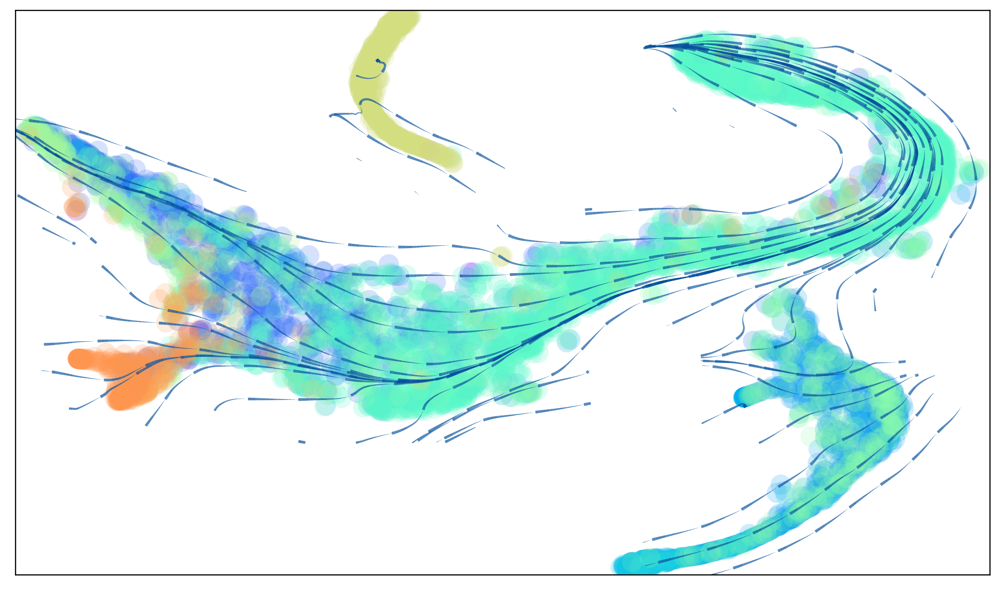

(<Figure size 1200x720 with 1 Axes>, <AxesSubplot:>)

In [16]:
sc.settings.set_figure_params(dpi=120, facecolor='white')
#the streamlines load very slowly through the Notebook, so see the code below to open the file and view the animation properly
via.animated_streamplot(v0, embedding=tsnem, cmap_stream='Blues', scatter_size=200, scatter_alpha=0.2, marker_edgewidth=0.15, 
                        density_grid=0.7, linewidth=0.1, segment_length=1.5, saveto='/home/shobi/Trajectory/Datasets/HumanCD34/HumanCD34_animation_Jan3.gif')

In [14]:
from IPython.display import Image

with open('./Figures/HumanCD34_animation.gif','rb') as file:
    display(Image(file.read()))

## Animated edge bundle plot

making hammerbundle
2022-11-08 16:46:46.082215	Start kmeans milestone
2022-11-08 16:46:50.162267	End kmeans milestone
2022-11-08 16:46:50.230431	Recompute weights
2022-11-08 16:46:50.348908	pruning milestone graph based on recomputed weights
2022-11-08 16:46:50.358479	Graph has 1 connected components before pruning
2022-11-08 16:46:50.358479	Graph has 1 connected components before pruning
2022-11-08 16:46:50.368028	regenerate igraph on pruned edges
2022-11-08 16:46:50.456737	make node dataframe
2022-11-08 16:46:50.472879	Setting numeric label as time_series_labels or other sequential metadata for coloring edges
2022-11-08 16:46:50.592365	Hammer bundling
seg weight 0.1311759587041706


MovieWriter imagemagick unavailable; using Pillow instead.


2022-11-08 16:47:46.937861	Finished plotting edge bundle
times series order set [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
number cycles if no time_series labels given 40.0
complete animate
inside update 0 out of 120
inside update 0 out of 120
inside update 1 out of 120
inside update 2 out of 120
inside update 3 out of 120
inside update 4 out of 120
inside update 5 out of 120
inside update 6 out of 120
inside update 7 out of 120
inside update 8 out of 120
inside update 9 out of 120
inside update 10 out of 120
inside update 11 out of 120
inside update 12 out of 120
inside update 13 out of 120
inside update 14 out of 120
inside update 15 out of 120
inside update 16 out of 120
inside update 17 out of 120
inside update 18 out of 120
inside update 19 out of 120
inside update 20 out of 120
inside update 21 out of 120
inside update 22 out of 120
inside update 23 out of 120
inside update 24 out of 120
inside update 25 out of 120
inside update 26 out of 120
inside update 27 out of 120
inside update 28 

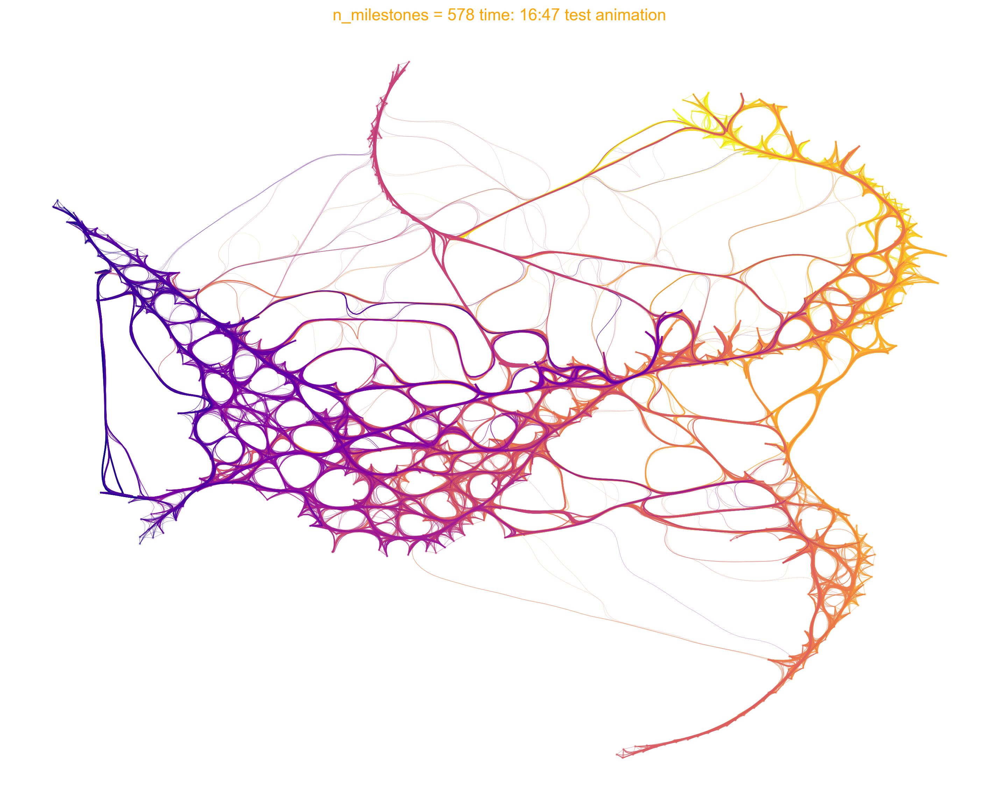

In [ ]:
via.animate_edge_bundle(via_object=v0, extra_title_text='test animation', n_milestones=None,
                        saveto='./Figures/human_edgebundle_test.gif')

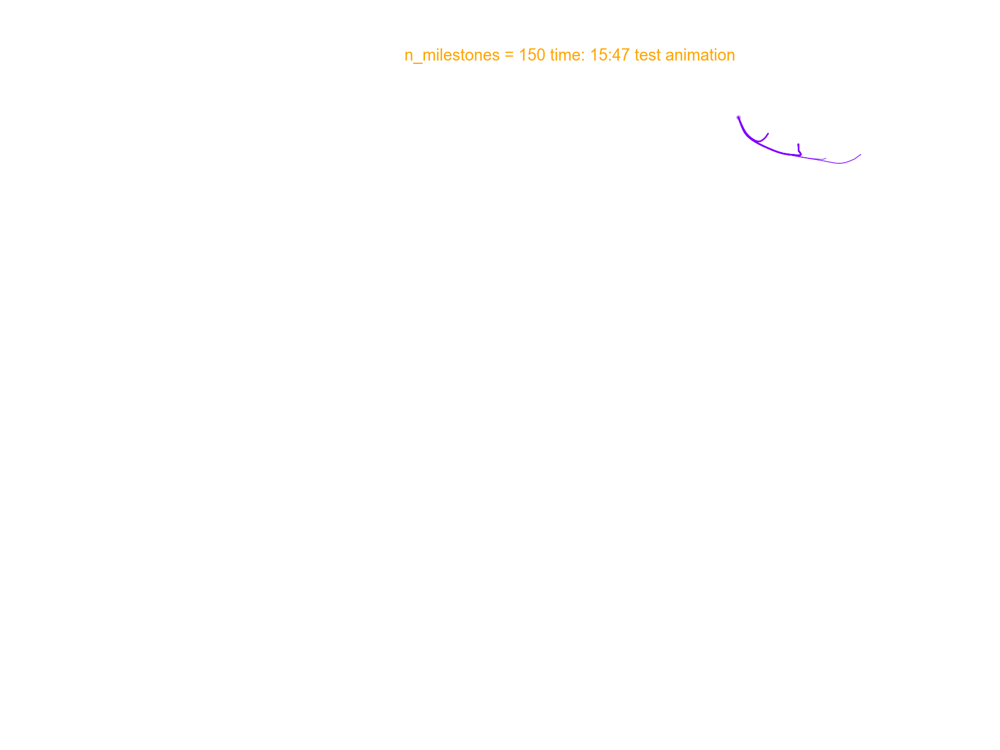

In [34]:
from IPython.display import Image
with open('/home/user/Github_local/VIA/Figures/human_edgebundle_test.gif','rb') as file:
    display(Image(file.read()))